# Experiment Evaluation of Activation Functions

In order to replicate and validate the experiment of Tishby, we tried different activation functions. We decided to test the same activation functions used by the opposing paper "On the Information Bottleneck Theory" by Saxe, Bansal, Dapello, Advani, Kolchinsky, Tracey and Cox. These included ReLU, tanh, Softplus and Softsign. Moreover, we added SELU, Leaky ReLU, ReLU6, ELU, Sigmoid, Hard-Sigmoid and a simple linear activation function. 

## 1. The Hypothesis

The opposing paper states that "the information plane trajectory is predominantly a function of the neural nonlinearity employed: **double-sided saturating nonlinearities** like tanh yield a **compression phase** as neural activations enter the saturation regime, but **linear activation functions and single-sided saturating nonlinearities** like the widely used ReLU in fact **do no not**" (Saxe et al., 2018, p.1).

Keep in mind that we have alreday seen before that this assumption holds true in our minimal modal analysis in a numeric simulation. 

## 2. Experimental Setting

In the following experiment we tested the eleven activation functions mentioned above with the following **parameter settings**: 

- Dataset: Harmonics
- Architecture: [10, 7, 5, 4, 3]
- Batchsize: 256
- Calculate MI for: full dataset
- Discretization range: 0.001
- Epochs: 8000
- Estimator: mi_upper 
- Learning rate: 0.0004
- Model: models.feedforward
- n_runs: 5
- Optimizer: Adam
- Regularization: False
- Seed: 0

Note that we sticked to the standard architecture used in Tishby's experiments, used the full dataset and the mutual information upper estimator. The reasons for using these settings can be found in previous experiments (see cohort_1 to cohort_5). 

## 3. Results

Import ArtifactLoader and instantiate it.

In [1]:
import sys
sys.path.append('../..')
from iclr_wrap_up.artifact_viewer import ArtifactLoader
import matplotlib.pyplot as plt
from io import BytesIO

In [2]:
loader = ArtifactLoader()

We varied the 11 activation functions. The experiments are named e.g. **cohort_5_activationfn_tanh**. The experiment ID's are the following:  
- 210 (hard sigmoid, double-saturated), 
- 211 (softplus, single-saturated), 
- 212 (tanh, double-saturated), 
- 213 (selu, single-saturated), 
- 214 (sigmoid, double-saturated), 
- 215 (relu6, double-saturated), 
- 216 (elu, single-saturated), 
- 217 (softsign, double-saturated), 
- 218 (leaky relu, single-saturated), 
- 219 (relu, single-saturated),
- 220 (linear, single-saturated).

### 3.1 Infoplane Plots

Taking a look at the infoplane plots, one can see that the assumption that only double-saturated activation functions have a compression phase does **not** hold true. With 98.78% accuracy ELU works best, whereas the linear function produces the worst results with an accuracy of 88.4%. 

Only the double-saturated **tanh** activation function clearly shows a compression phase - especially in layer 3 and 4.

In [4]:
fig, ax = plt.subplots(6, 2, figsize=(200, 200))
ax = ax.flat
activationfunctions = ['hard sigmoid','softplus', 'tanh', 'selu', 'sigmoid', 'relu6', 
                       'elu', 'softsign', 'leaky relu', 'relu', 'linear']

for i,n in enumerate([210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220]):
    artifacts = loader.load(experiment_id=n)
    byte = artifacts['infoplane'].content
    img = plt.imread(BytesIO(byte))
    ax[i].axis('off')
    ax[i].imshow(img)
    ax[i].set_title(activationfunctions[i], fontsize=150)

plt.tight_layout()

### 3.2 Compression of Each Layer for ReLU and tanh

In order to get a better understanding how compression happens, we plot the mutual information of the input per layer over the epochs for our n=5 runs. A decreasing graph therefore indicates compression. 

Note that the last layer - here layer 5 - is the softmax layer. 

**Layer 1**: no compression, neither for ReLU, nor for tanh is happening. The mutual information of the input stays the same at around 12.

**Layer 2**: One can clearly see that ReLU4 initially starts below all other activation functions (at around 8 after 8000 epochs. The mutual information of tanh is generally higher or equal than ReLU. No compression is visible.

**Layer 3**: It displays the same situation as in layer 2. It becomes more obvious that the mutual information of tanh is above ReLU. 

**Layer 4**: Same situation as in layer 3 but ReLU4 shows a little bit of compression.

**Layer 5**: This layer clearly shows compression for all 5 runs of tanh. Moreover, ReLU has generally a higher mutual information than tanh. 

**Layer 6**: Here the softmax function is applied, i.e. the outputs are in the range (0, 1], and all the entries add up to 1. The mutual information of tanh stays underneath ReLU and therefore performs better. 

To conclude: Only tanh really shows compression (decreasing graph) in layer 4.

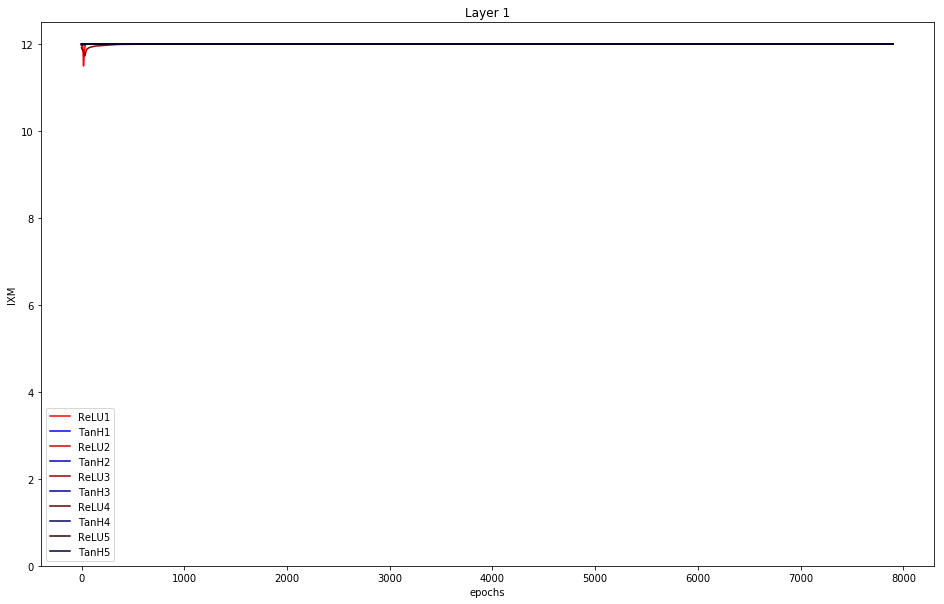

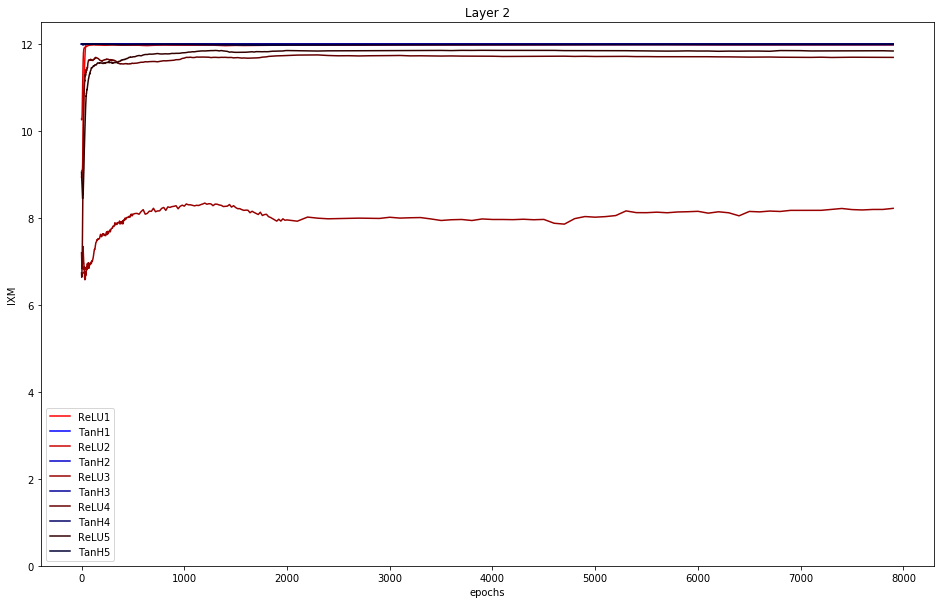

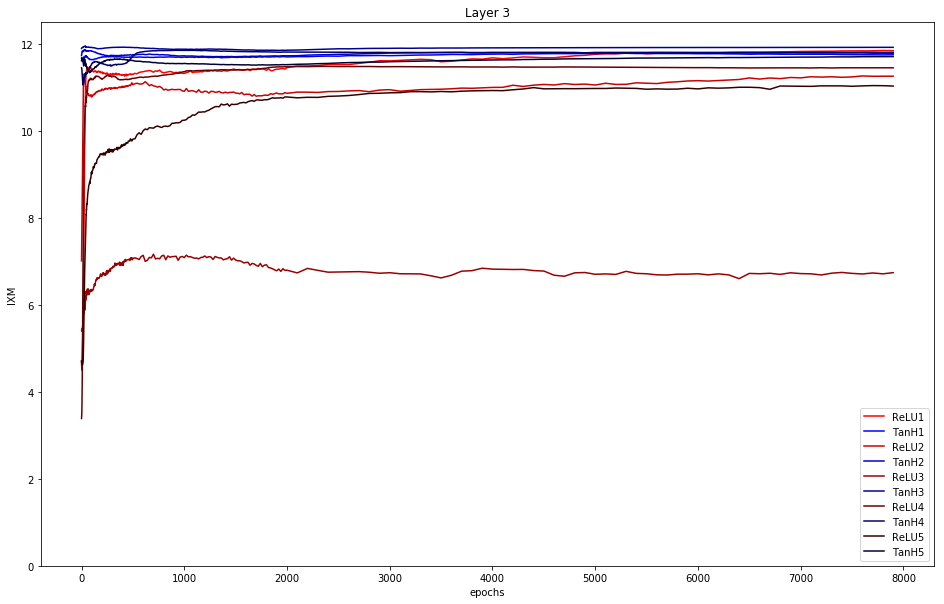

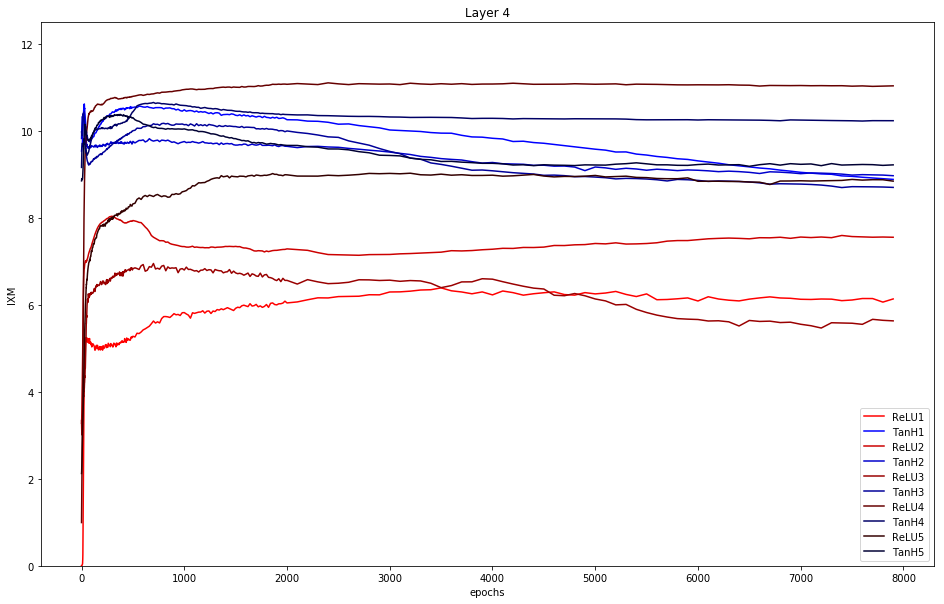

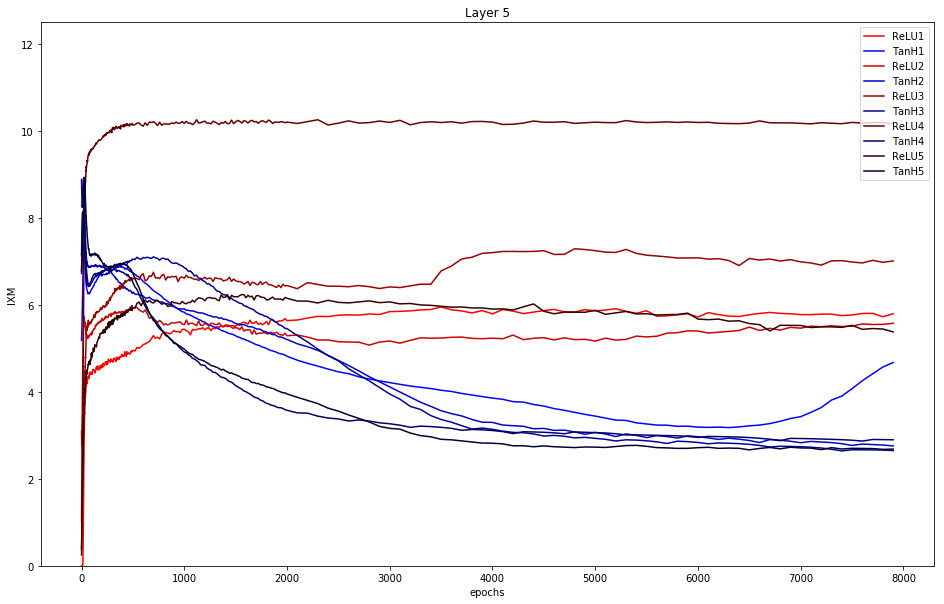

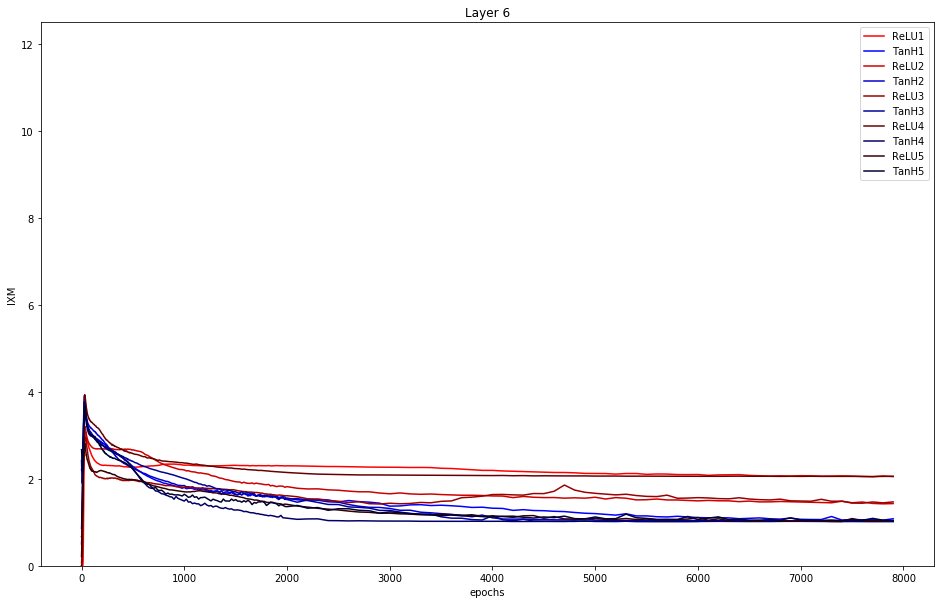

In [10]:
artifacts_relu = loader.load(experiment_id=219)
relucsv = artifacts_relu['information_measures'].show()
artifacts_tanh = loader.load(experiment_id=212)
tanhcsv = artifacts_tanh['information_measures'].show()

for layer in range(0,6):
    plt.figure(figsize=(16,10))
    for run in range(0,5):
        epochs = relucsv[(relucsv['run'] == run) & (relucsv['layer'] == layer)]['epoch'].values
        mixm_relu = relucsv[(relucsv['run'] == run) & (relucsv['layer'] == layer)]['MI_XM'].values
        mixm_tanh = tanhcsv[(tanhcsv['run'] == run) & (tanhcsv['layer'] == layer)]['MI_XM'].values
        cr = [1-0.2*run,0,0]
        cb = [0,0,1-0.2*run]
        plt.plot(epochs, mixm_relu, color=cr,label="ReLU{}".format(run+1))
        plt.plot(epochs, mixm_tanh, color=cb, label="TanH{}".format(run+1))
        plt.ylim([0,12.5])
        plt.xlabel("epochs")
        plt.ylabel("IXM")
        plt.title("Layer {}".format(layer+1))
        plt.legend()
    plt.show()

**Summary**: only tanh shows compression with the given parameter setting. This does neither support the hypothesis of the opposing paper that only double-saturated activation functions show compression, nor supports Tishby. 